In [109]:
import pandas as pd
import scanpy as sc
import numpy as np
import sys
import matplotlib.pyplot as plt

sys.path.insert(1, '/cndd3/dburrows/CODE/admin_tools/')
from admin_tools import admin_functions as adm

# Pre-process data

In [83]:
data_path = '/cndd3/dburrows/DATA/neuroswitch/pilot/QY_2252_1_2'
adata = sc.read_10x_mtx(data_path)

#Calculate QC metrics
adata.var['mt'] = adata.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pp.calculate_qc_metrics(adata, inplace=True)


In [56]:
adata

AnnData object with n_obs × n_vars = 19883 × 31053
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_mean_counts', 'log1p_total_counts'

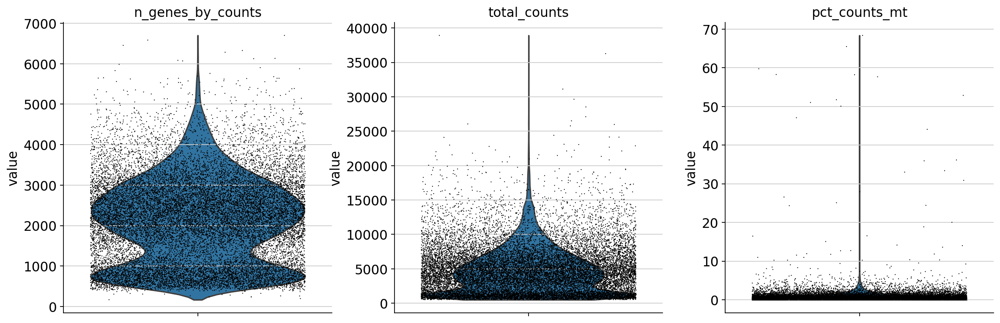

In [63]:
##QC -> by cell statistics
##========================
sc.set_figure_params(figsize=(8,5))

sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)


In [45]:
adata.obs['n_genes_by_counts'], adata.obs['total_counts'], adata.obs['pct_counts_mt']

(AAACCCAAGAGATCGC-1    2997
 AAACCCAAGAGCACTG-1    2317
 AAACCCAAGGAGATAG-1    2483
 AAACCCAAGGATCATA-1    2331
 AAACCCAAGGGAGGAC-1    1000
                       ... 
 TTTGTTGTCGTGGCGT-1    1800
 TTTGTTGTCTACGGTA-1    2018
 TTTGTTGTCTTCCAGC-1    3064
 TTTGTTGTCTTCTTCC-1    3057
 TTTGTTGTCTTGTTAC-1    2472
 Name: n_genes_by_counts, Length: 19883, dtype: int32,
 AAACCCAAGAGATCGC-1    7243.0
 AAACCCAAGAGCACTG-1    4674.0
 AAACCCAAGGAGATAG-1    5572.0
 AAACCCAAGGATCATA-1    4772.0
 AAACCCAAGGGAGGAC-1    1413.0
                        ...  
 TTTGTTGTCGTGGCGT-1    3126.0
 TTTGTTGTCTACGGTA-1    4070.0
 TTTGTTGTCTTCCAGC-1    7701.0
 TTTGTTGTCTTCTTCC-1    8154.0
 TTTGTTGTCTTGTTAC-1    5163.0
 Name: total_counts, Length: 19883, dtype: float32,
 AAACCCAAGAGATCGC-1    0.952644
 AAACCCAAGAGCACTG-1    0.171160
 AAACCCAAGGAGATAG-1    1.722900
 AAACCCAAGGATCATA-1    0.083822
 AAACCCAAGGGAGGAC-1    0.141543
                         ...   
 TTTGTTGTCGTGGCGT-1    0.895713
 TTTGTTGTCTACGGTA-1    0.245700

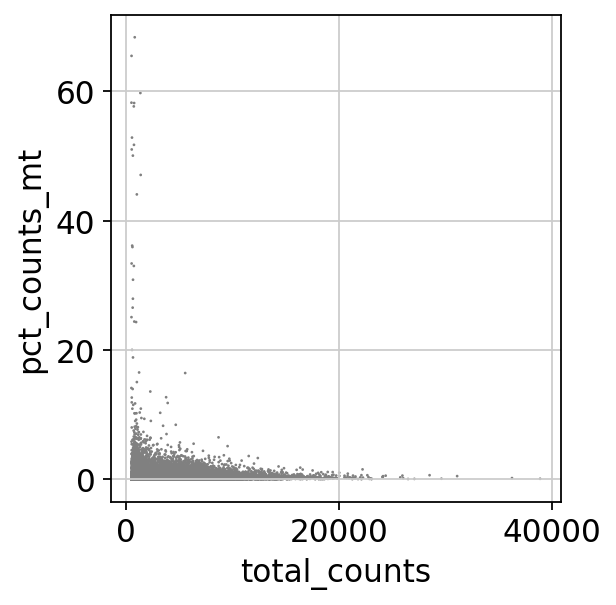

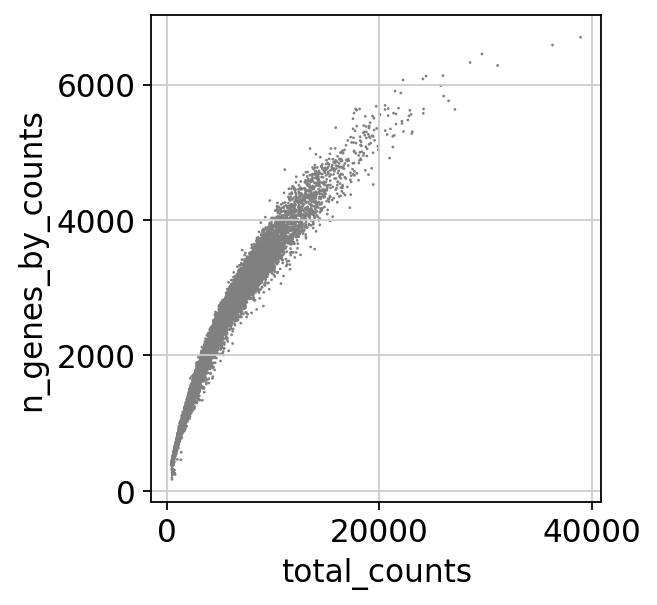

In [59]:
##QC -> by cell statistics; cell total counts x 
##========================
sc.set_figure_params(figsize=(4,4))
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [84]:
#Process
##========================

#Filter based on QC
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_cells(adata, max_genes=5000)
sc.pp.filter_genes(adata, min_cells=3)
adata = adata[adata.obs.pct_counts_mt < 5, :]

#Normalise
sc.pp.normalize_total(adata, target_sum=1e6)

#Log1p
sc.pp.log1p(adata)

/home/dburrows/mambaforge/envs/base_conda/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [290]:
sc.pp.log1p?

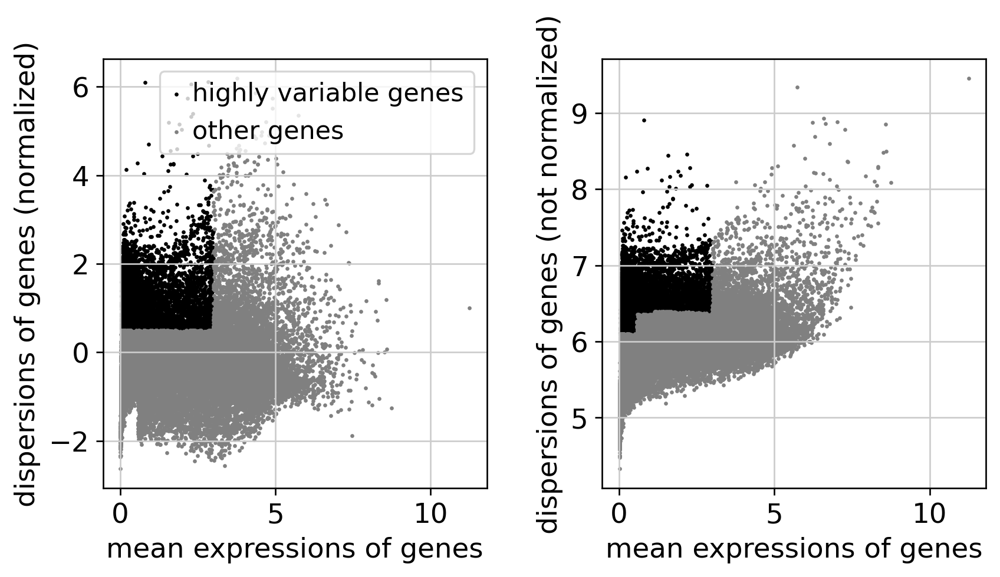

/tmp/ipykernel_3243565/3189672551.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.var.highly_variable[i] = True


In [199]:
#Filter to only highly expressed + marker genes -> NB this may need to be tweaked
#Define marker genes
gaba_mark = ['Gad2', 'Gad1','Slc32a1']
glu_mark = ['Slc17a7', 'Slc17a6']
astro_mark = ['Gfap', 'Aldh1l1', 'S100b', 'Aqp4']
oli_mark = ['Mbp', 'Mog', 'Cnp', 'Plp1','Sox10', 'Olig2', 'Olig1']
mi_mark = ['Aif1', 'Cd68', 'Tmem119', 'P2ry12', 'Ptprc']
opc_mark = ['Sox10', 'Olig2', 'Olig1']

comb_l = gaba_mark+glu_mark+astro_mark+oli_mark+mi_mark+opc_mark

#Plot variable vs non variable genes
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)

#Add in all marker genes
for i in comb_l:
    if adata.var.highly_variable[i] == False: 
        adata.var.highly_variable[i] = True

#Retain only most variable genes
adata.raw = adata
fdata = adata[:,adata.var.highly_variable]
# sc.pp.regress_out(fdata, ['total_counts', 'pct_counts_mt'])
# sc.pp.scale(fdata, max_value=10)


In [135]:
fdata

View of AnnData object with n_obs × n_vars = 19644 × 4422
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'log1p_n_genes_by_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'n_genes'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_mean_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

/home/dburrows/mambaforge/envs/base_conda/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:843: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


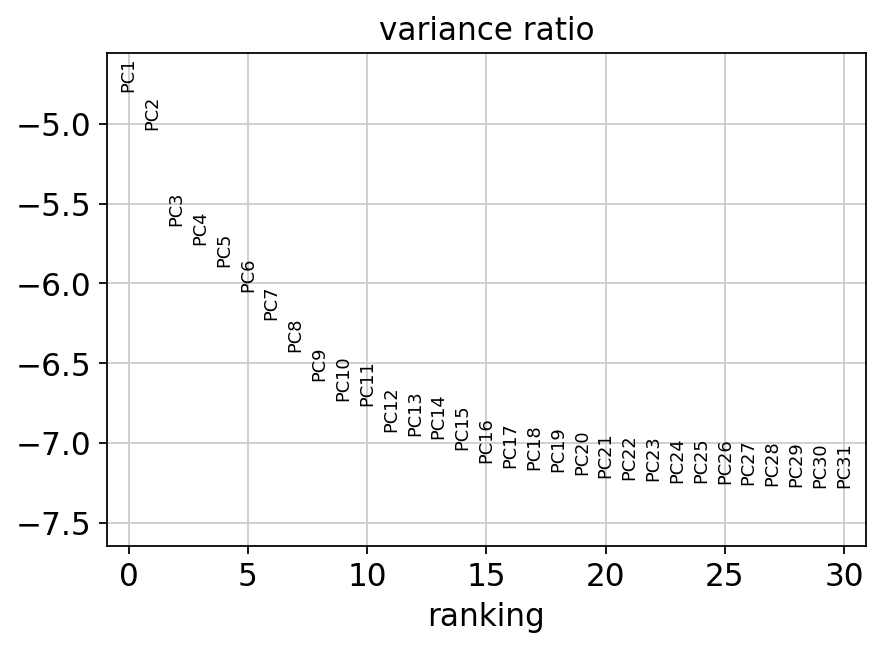

In [200]:
#PCA
sc.set_figure_params(figsize=(6,4))
sc.pp.scale(fdata, max_value=20) #scale data for PCA
sc.tl.pca(fdata, svd_solver='arpack')
sc.pl.pca_variance_ratio(fdata, log=True)

# Cluster data

In [201]:
#UMAP embedding
sc.pp.neighbors(fdata, n_neighbors=10, n_pcs=20)
sc.tl.umap(fdata)
#Louvain clustering
sc.tl.louvain(fdata)

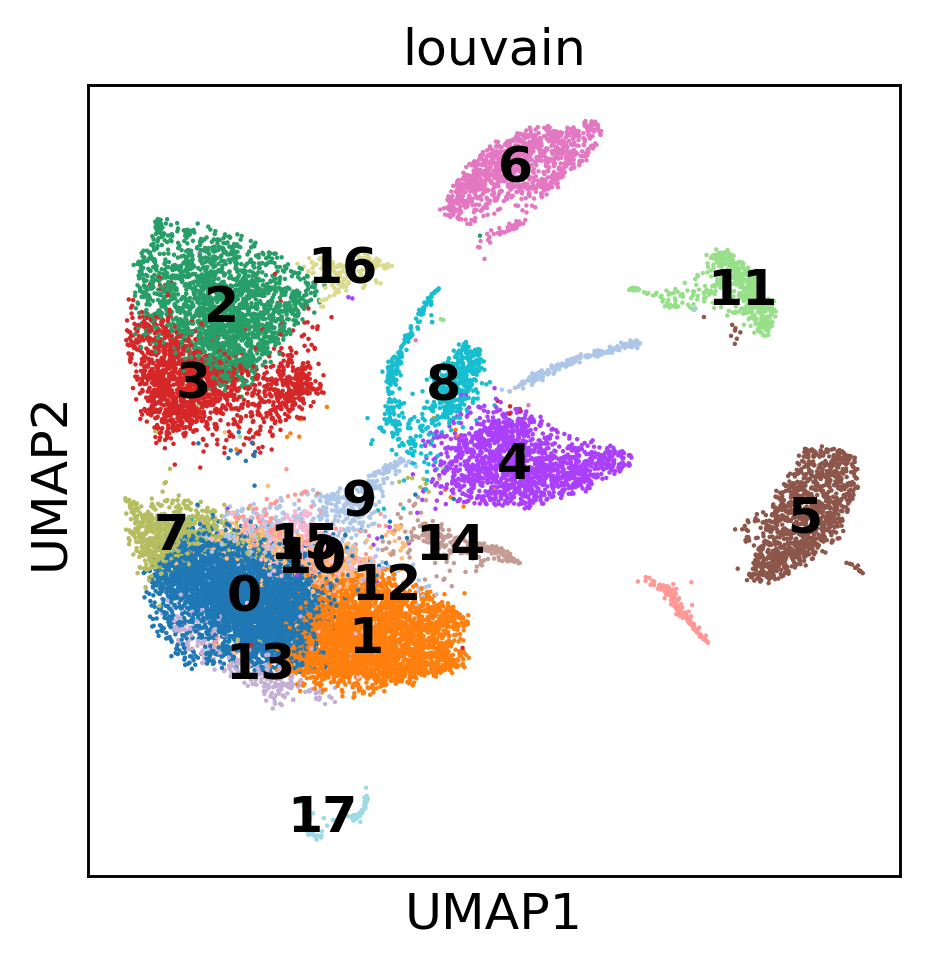

In [202]:
# UMAP by cluster, glu and gaba markers
sc.set_figure_params(figsize=(3,3))
sc.set_figure_params(dpi=130)
sc.pl.umap(fdata,color=['louvain'],legend_loc='on data')

In [118]:
fdata.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,log1p_n_genes_by_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,n_genes,louvain
AAACCCAAGAGATCGC-1,2997,7243.0,69.0,0.952644,8.005701,8.887929,24.451194,31.630540,41.184592,56.633991,2997,1
AAACCCAAGAGCACTG-1,2317,4674.0,8.0,0.171160,7.748460,8.449985,22.635858,30.124091,39.602054,55.862217,2317,9
AAACCCAAGGAGATAG-1,2483,5572.0,96.0,1.722900,7.817625,8.625689,24.982053,33.094042,42.552046,58.722182,2483,8
AAACCCAAGGATCATA-1,2331,4772.0,4.0,0.083822,7.754482,8.470731,24.937133,32.732607,42.015926,57.439229,2331,4
AAACCCAAGGGAGGAC-1,1000,1413.0,2.0,0.141543,6.908755,7.254178,22.009908,30.148620,43.382873,64.614296,1000,11
...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCGTGGCGT-1,1800,3126.0,28.0,0.895713,7.496097,8.047830,23.448496,30.454255,40.211132,58.413308,1800,3
TTTGTTGTCTACGGTA-1,2018,4070.0,10.0,0.245700,7.610358,8.311644,28.476658,35.577396,44.471744,60.884521,2018,0
TTTGTTGTCTTCCAGC-1,3064,7701.0,44.0,0.571354,8.027803,8.949235,25.788859,33.580055,42.397091,56.966628,3064,1
TTTGTTGTCTTCTTCC-1,3057,8154.0,13.0,0.159431,8.025516,9.006387,30.623007,38.091734,46.357616,59.946039,3057,4


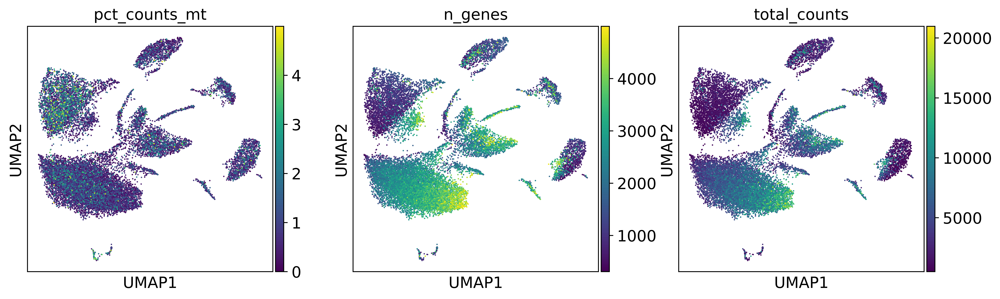

In [203]:
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(18,14))
sc.set_figure_params(dpi=500)
sc.pl.umap(fdata,color=['pct_counts_mt', 'n_genes', 'total_counts'],legend_loc='on data')

In [149]:
fdata.obs

,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,log1p_n_genes_by_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,n_genes,louvain
AAACCCAAGAGATCGC-1,2997,7243.0,69.0,0.952644,8.005701,8.887929,24.451194,31.630540,41.184592,56.633991,2997,2
AAACCCAAGAGCACTG-1,2317,4674.0,8.0,0.171160,7.748460,8.449985,22.635858,30.124091,39.602054,55.862217,2317,1
AAACCCAAGGAGATAG-1,2483,5572.0,96.0,1.722900,7.817625,8.625689,24.982053,33.094042,42.552046,58.722182,2483,1
AAACCCAAGGATCATA-1,2331,4772.0,4.0,0.083822,7.754482,8.470731,24.937133,32.732607,42.015926,57.439229,2331,5
AAACCCAAGGGAGGAC-1,1000,1413.0,2.0,0.141543,6.908755,7.254178,22.009908,30.148620,43.382873,64.614296,1000,9
...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGTCGTGGCGT-1,1800,3126.0,28.0,0.895713,7.496097,8.047830,23.448496,30.454255,40.211132,58.413308,1800,0
TTTGTTGTCTACGGTA-1,2018,4070.0,10.0,0.245700,7.610358,8.311644,28.476658,35.577396,44.471744,60.884521,2018,1
TTTGTTGTCTTCCAGC-1,3064,7701.0,44.0,0.571354,8.027803,8.949235,25.788859,33.580055,42.397091,56.966628,3064,1
TTTGTTGTCTTCTTCC-1,3057,8154.0,13.0,0.159431,8.025516,9.006387,30.623007,38.091734,46.357616,59.946039,3057,5


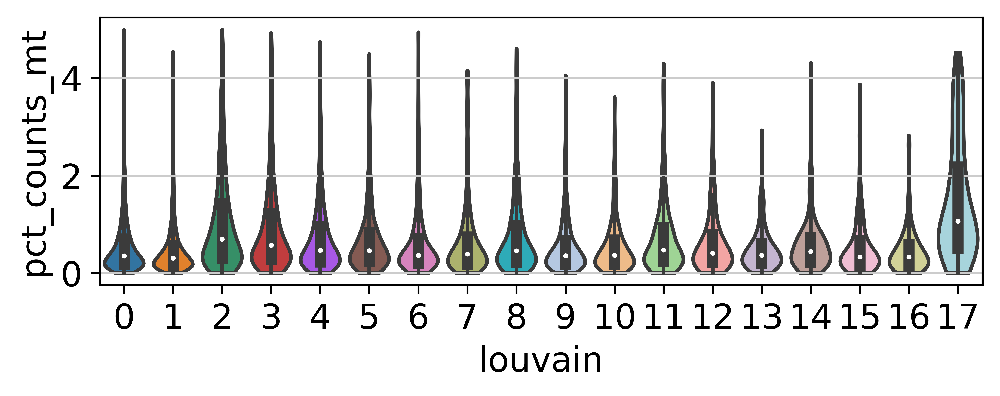

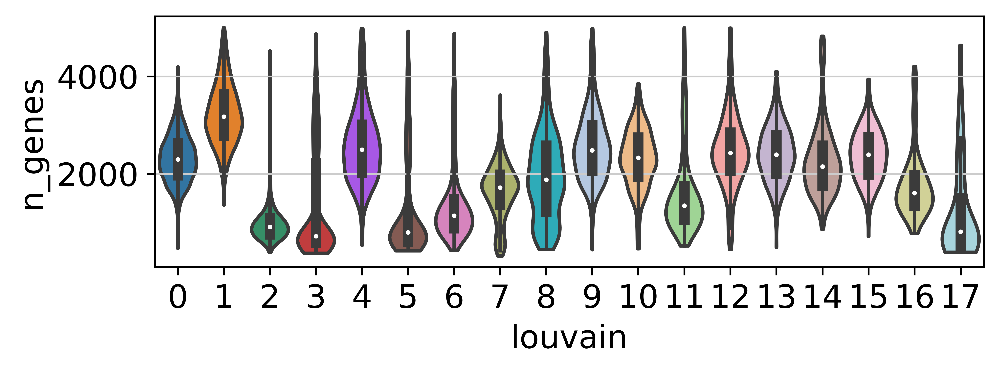

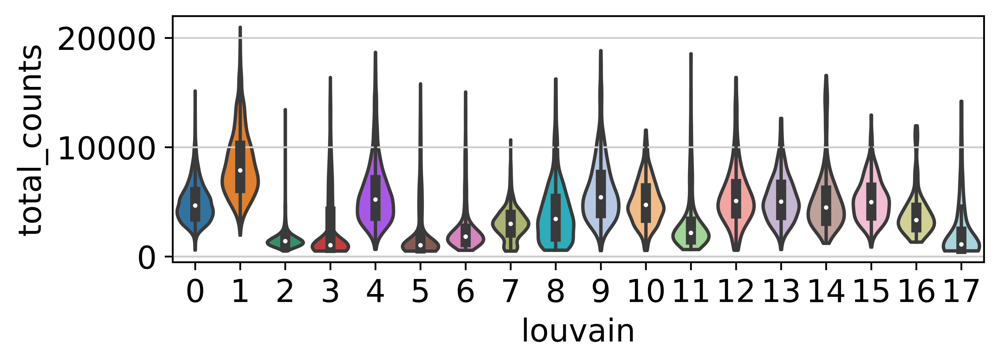

In [204]:
from matplotlib.pyplot import rc_context
# Cluster metrics

with rc_context({'figure.figsize': (6, 2)}):
    sc.pl.violin(fdata, ['pct_counts_mt'], groupby='louvain', stripplot=False, inner='box')  
    
with rc_context({'figure.figsize': (6, 2)}):
    sc.pl.violin(fdata, ['n_genes'], groupby='louvain', stripplot=False, inner='box')  

with rc_context({'figure.figsize': (6, 2)}):
    sc.pl.violin(fdata, ['total_counts'], groupby='louvain', stripplot=False, inner='box')  


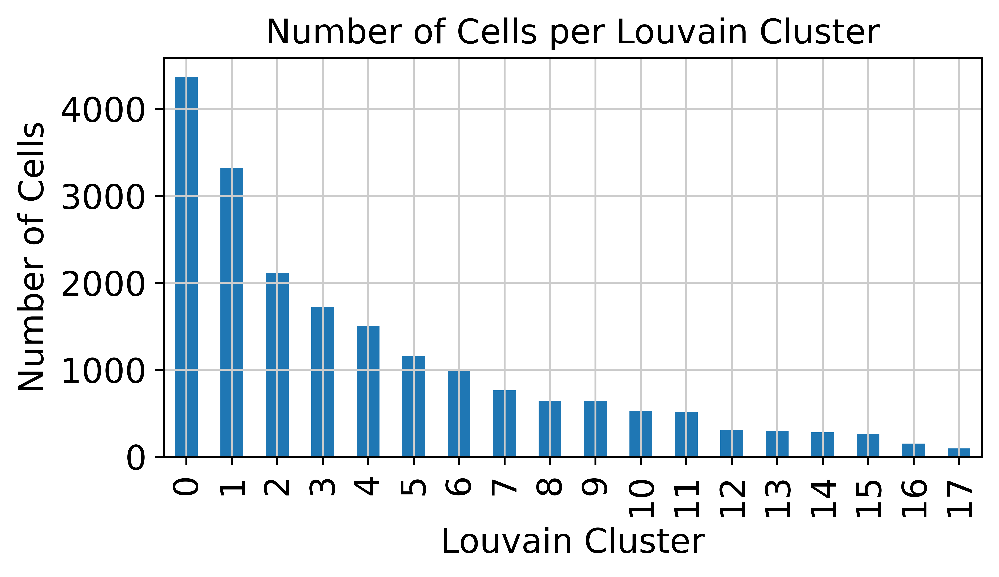

In [205]:
fig,ax = plt.subplots(figsize=(6,3))
cluster_counts = fdata.obs['louvain'].value_counts()

# Sort the clusters
cluster_counts = cluster_counts.sort_index()

# Create a bar plot
cluster_counts.plot(kind='bar')
plt.xlabel('Louvain Cluster')
plt.ylabel('Number of Cells')
plt.title('Number of Cells per Louvain Cluster')
plt.show()

In [207]:
print_l = gaba_mark,glu_mark,astro_mark,oli_mark,mi_mark,opc_mark
name_l = ['Gaba','Glu','Astro', 'Oli', 'Micro', 'OPC']
for x,i in enumerate(print_l):print(f'{name_l[x]}: {i}')

# Look at expression of Gaba, Glu and glial marker cells -> QC by
# How selective are cluster for Gaba only

#Dotplot of gene expression by
sc.pl.dotplot(fdata,var_names=list(comb_l),
              groupby='louvain',swap_axes=True)


Gaba: ['Gad2', 'Gad1', 'Slc32a1']
Glu: ['Slc17a7', 'Slc17a6']
Astro: ['Gfap', 'Aldh1l1', 'S100b', 'Aqp4']
Oli: ['Mbp', 'Mog', 'Cnp', 'Plp1', 'Sox10', 'Olig2', 'Olig1']
Micro: ['Aif1', 'Cd68', 'Tmem119', 'P2ry12', 'Ptprc']
OPC: ['Sox10', 'Olig2', 'Olig1']


In [170]:
glu_mark, gaba_mark

(['Slc17a7', 'Slc17a8', 'Slc17a6'], ['Gad2', 'Gad1', 'Slc32a1'])

In [208]:
#Calculate GLU + GABA + OLI mean exp
gaba_ind = [np.where(fdata.var.index.values == i)[0][0] for i in gaba_mark]
glu_ind = [np.where(fdata.var.index.values == i)[0][0] for i in glu_mark]
oli_ind = [np.where(fdata.var.index.values == i)[0][0] for i in oli_mark]
glu_ind, gaba_ind, oli_ind

([1895, 1913], [312, 400, 549], [4261, 4090, 3240, 712, 3757, 3948, 3949])

In [209]:
##for each cell calculate mean GLU vs GABA expression
fdata.obs['mean_glu']  = np.mean(fdata.X[:,glu_ind],axis=1)
fdata.obs['mean_gaba']  = np.mean(fdata.X[:,gaba_ind],axis=1)
fdata.obs['mean_oli']  = np.mean(fdata.X[:,oli_ind],axis=1)

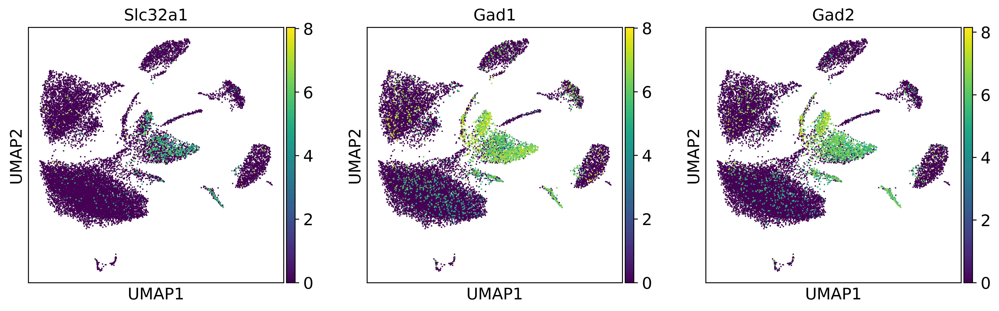

In [210]:
# Visualise GABA marker expression
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(6,6))
sc.set_figure_params(dpi=300)
sc.pl.umap(fdata,color=['Slc32a1', 'Gad1', 'Gad2'],legend_loc='on data')

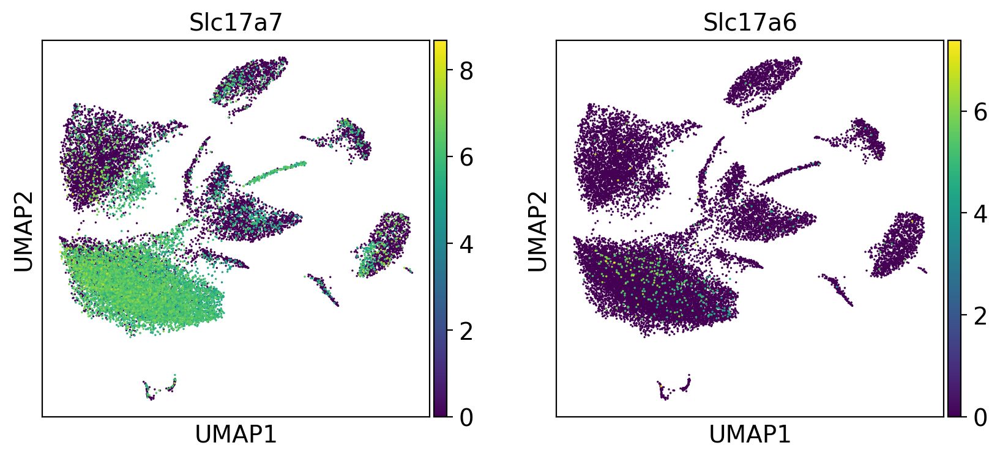

In [215]:
# Visualise GLU marker expression
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(4,4))
sc.set_figure_params(dpi=100)
sc.pl.umap(fdata,color=['Slc17a7', 'Slc17a6'],legend_loc='on data')

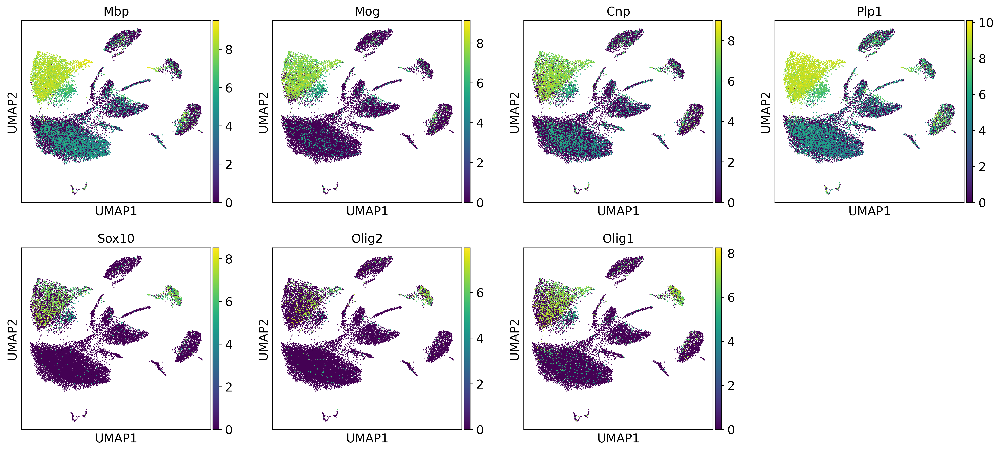

In [216]:
# Visualise OLI marker expression
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(6,6))
sc.set_figure_params(dpi=200)
sc.pl.umap(fdata,color=oli_mark,legend_loc='on data')

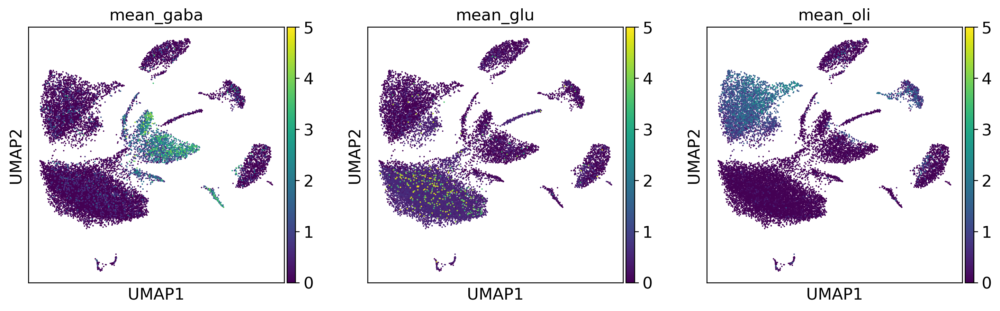

In [217]:
# Visualise mean expression for each cell type
# UMAP by cluster, sample and donor
sc.set_figure_params(figsize=(6,6))
sc.set_figure_params(dpi=120)
sc.pl.umap(fdata,color=['mean_gaba', 'mean_glu', 'mean_oli'],vmin = 0, vmax=5,legend_loc='on data')

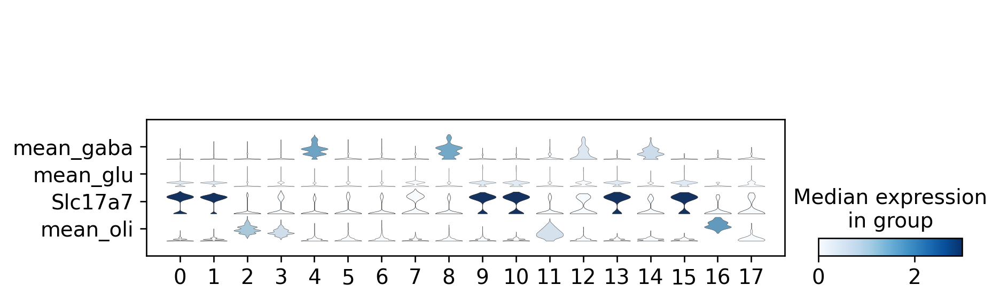

In [229]:
# Plot mean celltype expression for each cluster on joint violin

ax = sc.pl.stacked_violin(fdata,['mean_gaba', 'mean_glu', 'Slc17a7', 'mean_oli'],groupby='louvain', vmin=0, vmax=3,swap_axes=True)


In [253]:
# How many of each celltype do we have?
# Check for increasing threshold

#compute number of co-expressing vs singular as a function of cpm co-expression threshold
glu_vec = []
gaba_vec = []
oli_vec = []
steps = (np.geomspace(0.1,10))

for i in steps:
    glu_vec.append(sum(fdata.obs['mean_glu'].values > i))
    gaba_vec.append(sum(fdata.obs['mean_gaba'].values > i))
    oli_vec.append(sum(fdata.obs['mean_oli'].values > i))


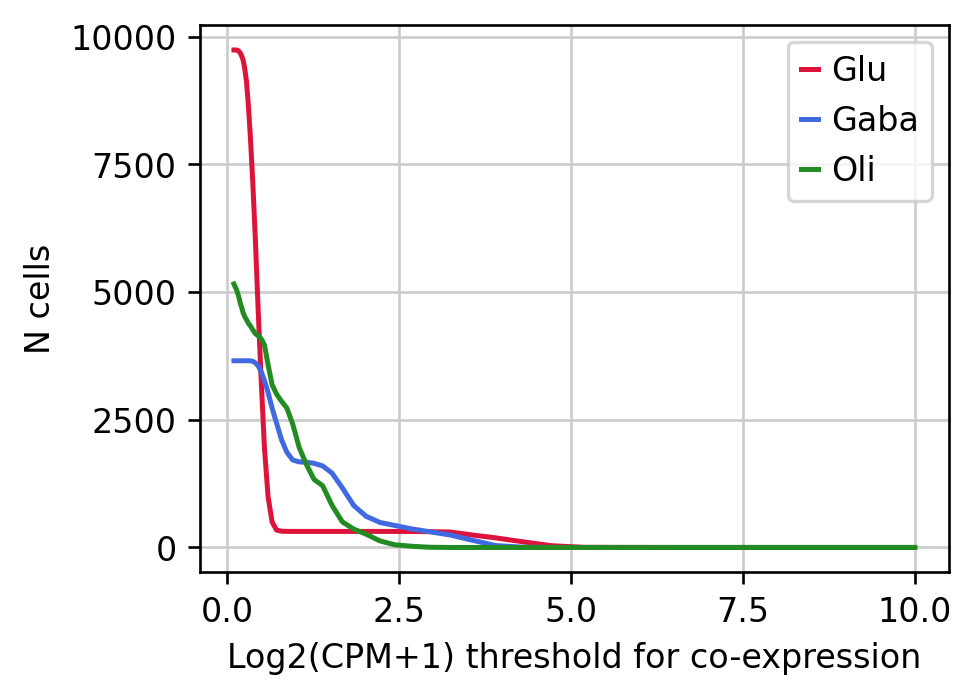

In [256]:
from matplotlib import pyplot as plt

#Plot N cells expressing celltype markers with increasing cutoff
fig,ax = plt.subplots(figsize=(4,3))
plt.plot(steps, glu_vec, label = 'Glu', c='crimson')
plt.plot(steps, gaba_vec, label = 'Gaba', c='royalblue')
plt.plot(steps, oli_vec, label = 'Oli', c='forestgreen')


#plt.xscale('log')
#plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('N cells', size=10)
plt.xlabel('Log2(CPM+1) threshold for co-expression', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
#plt.savefig('prac.svg')
plt.show()

# Quantify co-expression of Glu and Gaba

Gaba: ['Gad2', 'Gad1', 'Slc32a1']
Glu: ['Slc17a7', 'Slc17a6']


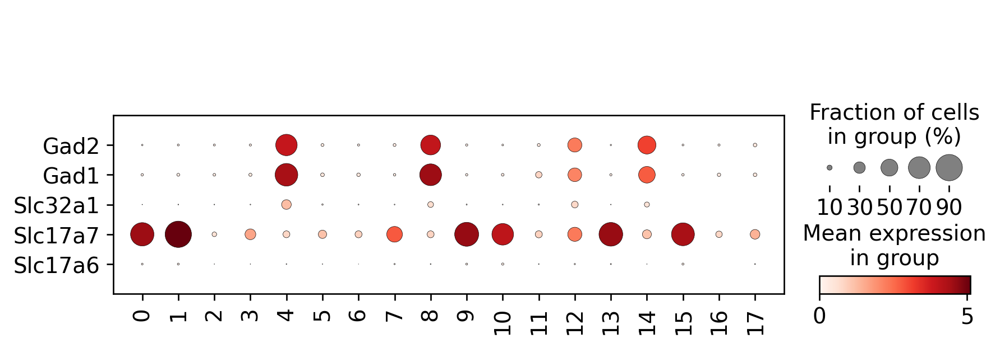

In [258]:
# Co-expression clusters?
print_l = gaba_mark,glu_mark
name_l = ['Gaba','Glu']
for x,i in enumerate(print_l):print(f'{name_l[x]}: {i}')

# Look at expression of Gaba, Glu and glial marker cells -> QC by
# How selective are cluster for Gaba only

#Dotplot of gene expression by
sc.pl.dotplot(fdata,var_names=list(gaba_mark+glu_mark),
              groupby='louvain',swap_axes=True)


4


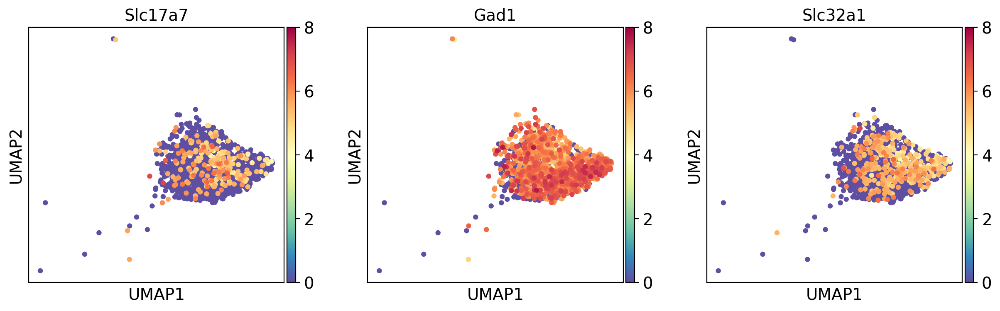

8


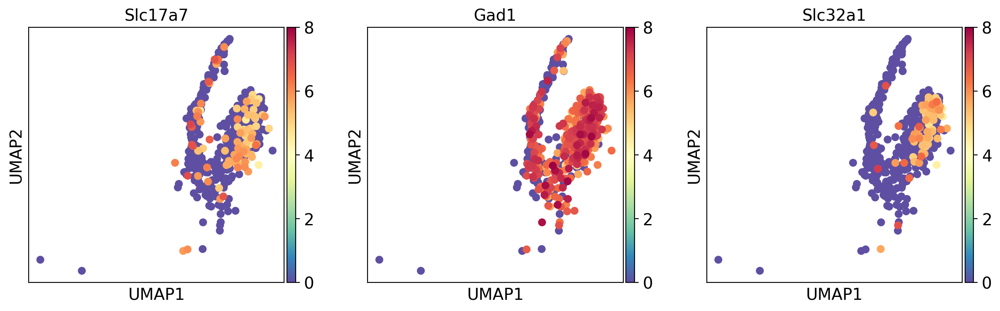

12


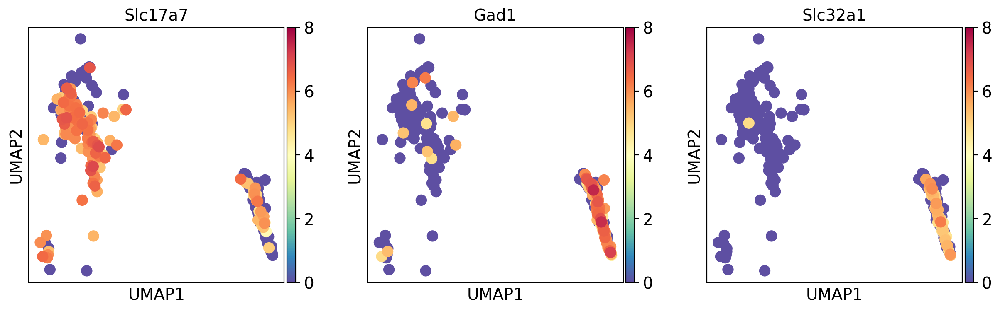

14


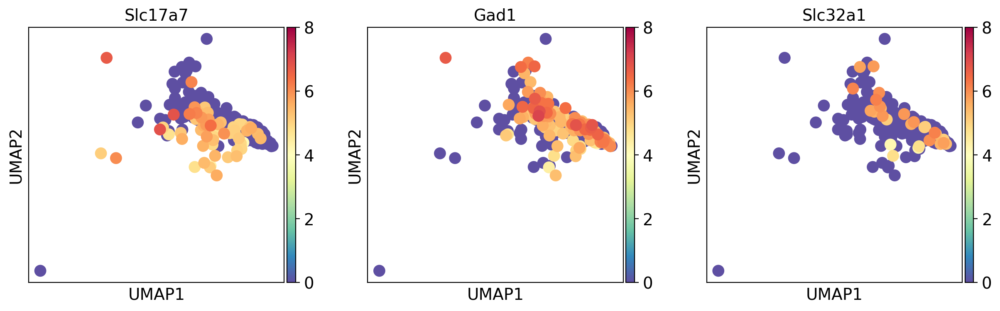

In [272]:
#Visualise each cluster

clust_list = [4,8,12,14]
for c in clust_list:
    print(c)
    curr_clust = fdata[fdata.obs['louvain'].values == str(c)]
    sc.set_figure_params(dpi=100)
    sc.pl.umap(curr_clust,color=['Slc17a7', 'Gad1', 'Slc32a1'],vmin=0, vmax=8,legend_loc='on data', cmap='Spectral_r')

In [275]:
(fdata.obs['mean_glu'] + fdata.obs['mean_gaba'])/2

AAACCCAAGAGATCGC-1    0.126216
AAACCCAAGAGCACTG-1    0.144425
AAACCCAAGGAGATAG-1    0.070837
AAACCCAAGGATCATA-1    0.693969
AAACCCAAGGGAGGAC-1    0.104679
                        ...   
TTTGTTGTCGTGGCGT-1   -0.428585
TTTGTTGTCTACGGTA-1    0.175090
TTTGTTGTCTTCCAGC-1    0.077765
TTTGTTGTCTTCTTCC-1    0.063145
TTTGTTGTCTTGTTAC-1    0.077288
Length: 19644, dtype: float32

In [285]:
#Go down to single cells

#Cluster 4 and 8
# What percentage of cells in cluster are co-expressing based on threshold

#calculate mean coexpression
fdata.obs['mean_coexp']  = (fdata.obs['mean_glu'] + fdata.obs['mean_gaba'])/2

#compute number of co-expressing vs singular as a function of cpm co-expression threshold
vec4, vec8, vec12, vec14 = [],[],[],[]
steps = (np.geomspace(0.1,10))
for i in steps:
    vec4.append(sum(fdata.obs['mean_coexp'][fdata.obs['louvain'] == str(4)] > i))
    vec8.append(sum(fdata.obs['mean_coexp'][fdata.obs['louvain'] == str(8)] > i))
    vec12.append(sum(fdata.obs['mean_coexp'][fdata.obs['louvain'] == str(12)] > i))
    vec14.append(sum(fdata.obs['mean_coexp'][fdata.obs['louvain'] == str(14)] > i))

In [289]:
sum(fdata.obs['louvain'] == str(4))

1503

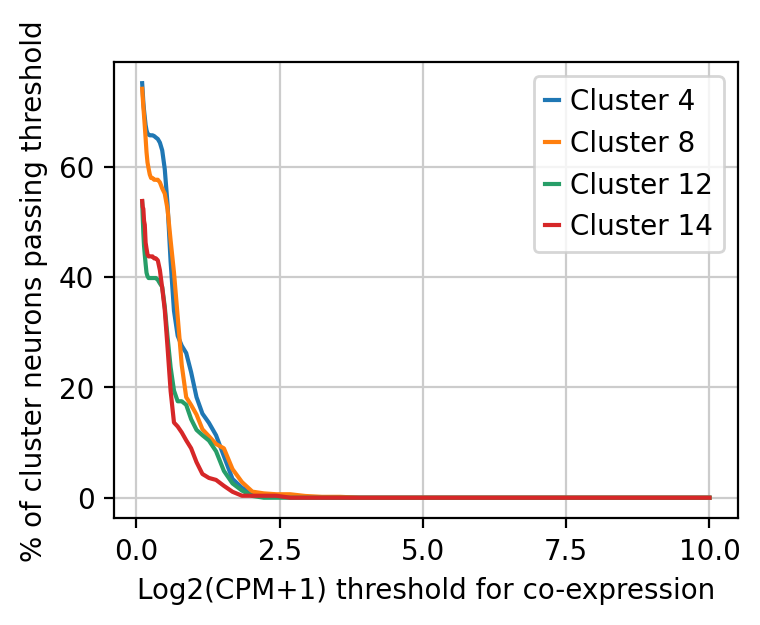

In [292]:
from matplotlib import pyplot as plt

#Plot N cells expressing celltype markers with increasing cutoff
fig,ax = plt.subplots(figsize=(4,3))
plt.plot(steps, (np.asarray(vec4)/sum(fdata.obs['louvain'] == str(4)))*100, label = 'Cluster 4')
plt.plot(steps, (np.asarray(vec8)/sum(fdata.obs['louvain'] == str(8)))*100, label = 'Cluster 8')
plt.plot(steps, (np.asarray(vec12)/sum(fdata.obs['louvain'] == str(12)))*100, label = 'Cluster 12')
plt.plot(steps, (np.asarray(vec14)/sum(fdata.obs['louvain'] == str(14)))*100, label = 'Cluster 14')


#plt.xscale('log')
#plt.yscale('log')
plt.legend(fontsize=10)
plt.ylabel('% of cluster neurons passing threshold', size=10)
plt.xlabel('Log2(CPM+1) threshold for co-expression', size=10)
plt.xticks(size=10)
plt.yticks(size=10)
#plt.savefig('prac.svg')
plt.show()

In [297]:
sub_bool = (fdata.obs['louvain'] == '4') |  (fdata.obs['louvain'] == '8') | (fdata.obs['louvain'] == '12')| (fdata.obs['louvain'] == '14')
sub_bool

AAACCCAAGAGATCGC-1    False
AAACCCAAGAGCACTG-1    False
AAACCCAAGGAGATAG-1    False
AAACCCAAGGATCATA-1     True
AAACCCAAGGGAGGAC-1    False
                      ...  
TTTGTTGTCGTGGCGT-1    False
TTTGTTGTCTACGGTA-1    False
TTTGTTGTCTTCCAGC-1    False
TTTGTTGTCTTCTTCC-1     True
TTTGTTGTCTTGTTAC-1    False
Name: louvain, Length: 19644, dtype: bool

In [303]:
fdata.obs['mean_glu'][sub_bool]

AAACCCAAGGATCATA-1   -0.548791
AAACCCATCGGCTGTG-1   -0.548791
AAACGAAGTGTTAAAG-1   -0.548791
AAACGAATCGCATTAG-1    0.305631
AAACGAATCTGAATCG-1   -0.548791
                        ...   
TTTGTTGAGCTGAAAT-1   -0.548791
TTTGTTGAGTGCCGAA-1   -0.548791
TTTGTTGCAACGTTAC-1   -0.548791
TTTGTTGGTGGGACAT-1   -0.548791
TTTGTTGTCTTCTTCC-1   -0.548791
Name: mean_glu, Length: 2728, dtype: float32

In [ ]:
mean_glu = np.mean(sub_mat[:,glu_ind],axis=1)
mean_gaba = np.mean(sub_mat[:,gaba_ind],axis=1)

import seaborn as sns
df = pd.DataFrame({'glu': mean_glu, 'gaba': mean_gaba})
sns.jointplot(data=df, x='glu', y='gaba', kind='kde')
plt.show()

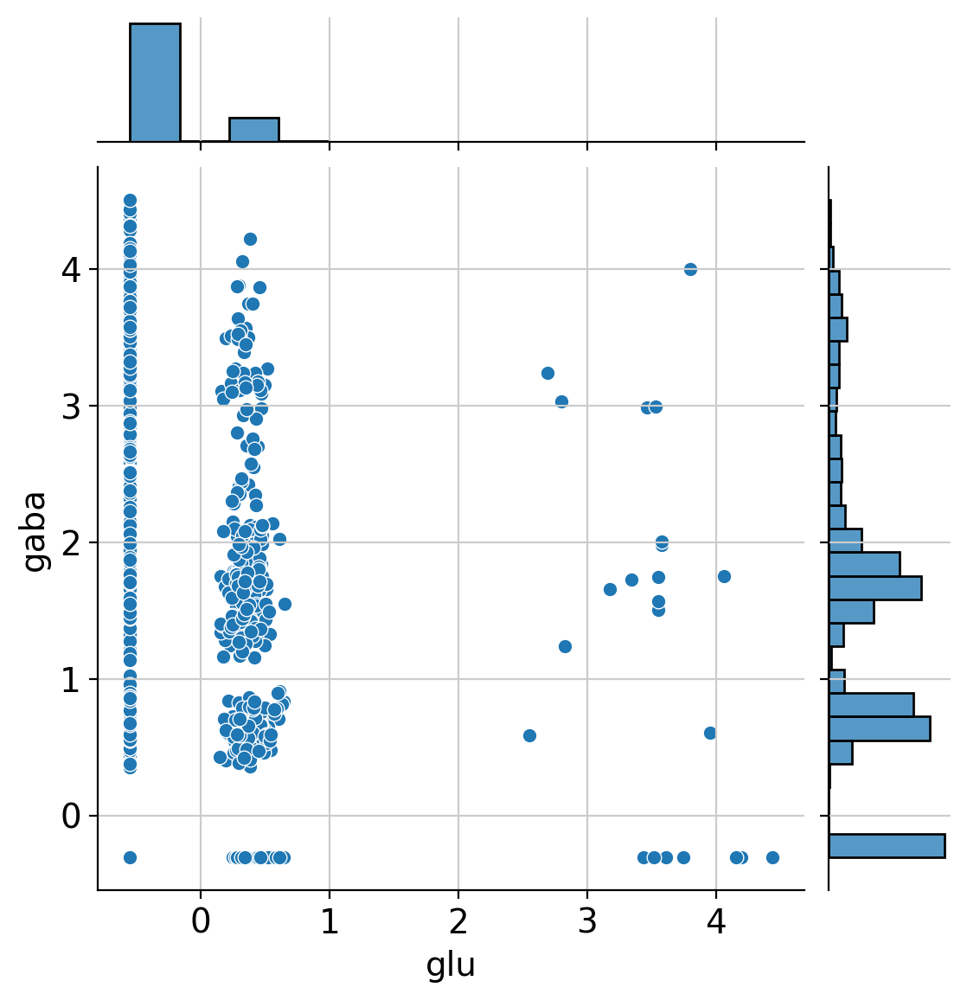

In [322]:
# Plot Glu vs Gaba 
# Direction of shift?

import seaborn as sns
df = pd.DataFrame({'glu': fdata.obs['mean_glu'][sub_bool], 'gaba': fdata.obs['mean_gaba'][sub_bool],
                  'cluster': fdata.obs['louvain'][sub_bool]})
sns.jointplot(data=df, x='glu', y='gaba'
             )#, ylim=(0,20000))
plt.show()

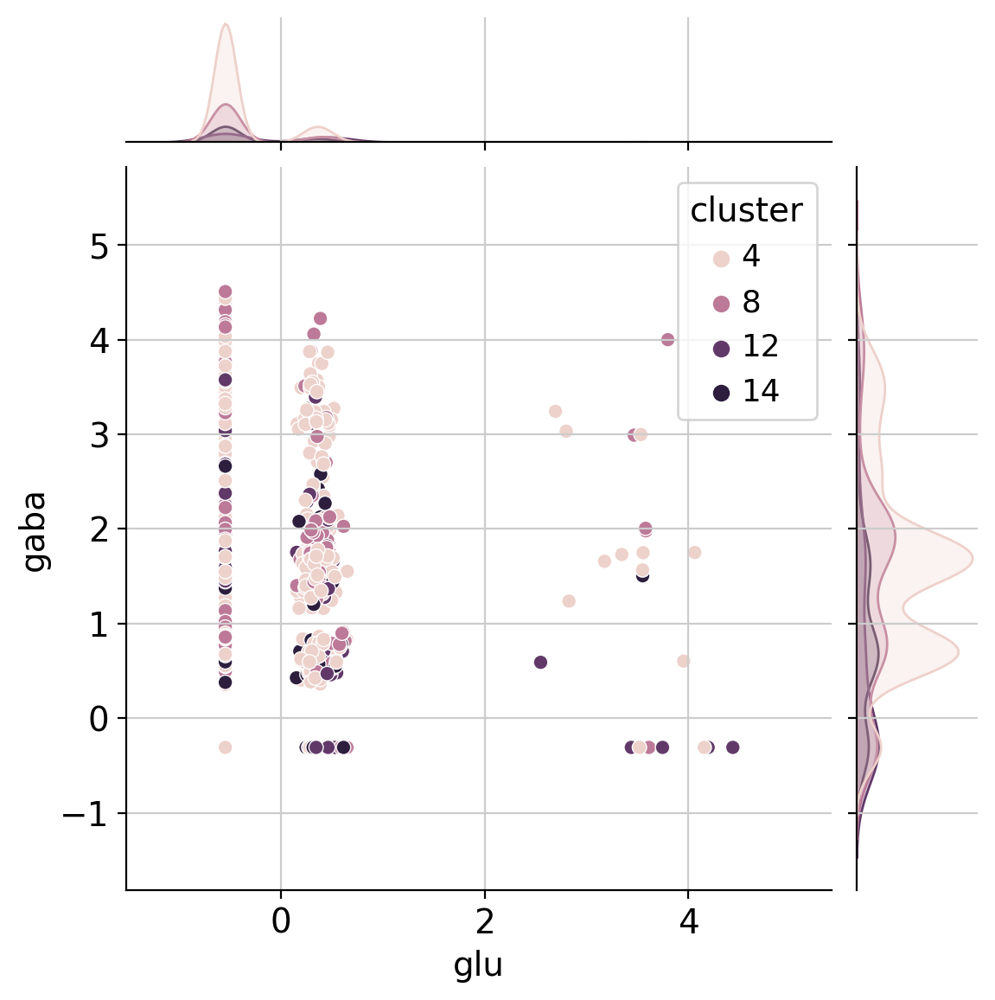

In [320]:
fdata.obs['louvain_int'] = fdata.obs['louvain'].cat.codes
# Plot Glu vs Gaba 
# Direction of shift?

import seaborn as sns
df = pd.DataFrame({'glu': fdata.obs['mean_glu'][sub_bool], 'gaba': fdata.obs['mean_gaba'][sub_bool],
                  'cluster': fdata.obs['louvain_int'][sub_bool]})
sns.jointplot(data=df, x='glu', y='gaba', hue = 'cluster')#, ylim=(0,20000))
plt.show()